<a href="https://colab.research.google.com/github/thisissamuca/EIAPI/blob/main/Estudo_03.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [76]:
pip install aspose-words

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 67.5 MB 105 kB/s 


In [77]:
import tensorflow as tf 
import keras
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd
import os
import random
import shutil
import PIL
import re
import PIL.Image
import aspose.words as aw
from random import randint
from random import sample
from keras import preprocessing 
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import RMSprop
from keras.preprocessing import image
#from keras.preprocessing.image import load_img
from urllib.request import Request, urlopen
from google.colab import drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
base_dir = '/content/drive/MyDrive/EIAPI/datasets/dataset_ML_03'
test_dir = "./test/"
train_dir = "./train/"

In [ ]:
# Diretório de treinamento

dataset_train_dir = os.path.join(base_dir, 'train')
dataset_train_quartz = os.path.join(dataset_train_dir, 'quartz')
dataset_train_pyrite = os.path.join(dataset_train_dir, 'pyrite')

# Diretorio de teste

dataset_test_dir = os.path.join(base_dir, 'test')
dataset_test_quartz = os.path.join(dataset_test_dir, 'quartz')
dataset_test_pyrite = os.path.join(dataset_test_dir, 'pyrite')

# Quantidade de figuras treinamento

dataset_train_quartz_len = len(os.listdir(os.path.join(dataset_train_dir, 'quartz')))
dataset_train_pyrite_len = len(os.listdir(os.path.join(dataset_train_dir, 'pyrite')))

# Quantidade de figuras teste

dataset_test_quartz_len = len(os.listdir(os.path.join(dataset_test_dir, 'quartz')))
dataset_test_pyrite_len = len(os.listdir(os.path.join(dataset_test_dir, 'pyrite')))

print('Train quartz: %s' % dataset_train_quartz_len)
print('Validation quartz: %s' % dataset_test_quartz_len)
print('---')
print('Train pyrite: %s' % dataset_train_pyrite_len)
print('Validation pyrite: %s' % dataset_test_pyrite_len)
print('---')

class_names = dataset_train.class_names

print(class_names)

Train quartz: 600
Validation quartz: 150
---
Train pyrite: 600
Validation pyrite: 150
---


In [ ]:
image_width = 300
image_height = 300
image_color_channel = 3
image_color_channel_size = 255
image_size = (image_width, image_height)
image_shape = image_size + (image_color_channel, )

batch_size = 32
epochs = 15
learning_rate = 0.0001

class_names = ['quartz', 'pyrite']

In [ ]:
dataset_train = tf.keras.preprocessing.image_dataset_from_directory(
    dataset_train_dir,
    seed=123,
    image_size = image_size,
    batch_size = batch_size,
    shuffle = True
)

# Dataset Test

dataset_test = tf.keras.preprocessing.image_dataset_from_directory(
    dataset_test_dir,
    seed=123,
    image_size = image_size,
    batch_size = batch_size,
)

# Dataset Cardinality

dataset_test_cardinality = tf.data.experimental.cardinality(dataset_test)
dataset_test_batches = dataset_test_cardinality // 5

dataset_validation = dataset_test.take(dataset_test_batches)
dataset_test = dataset_test.skip(dataset_test_batches)

print('---')
print('Validation Dataset Cardinality: %d' % tf.data.experimental.cardinality(dataset_test))
print('Test Dataset Cardinality: %d' % tf.data.experimental.cardinality(dataset_validation))

Found 1200 files belonging to 2 classes.
Found 300 files belonging to 2 classes.
---
Validation Dataset Cardinality: 8
Test Dataset Cardinality: 2


In [ ]:
# Importando um modelo neural

model_transfer_learning = tf.keras.applications.MobileNetV2(input_shape = image_shape, include_top = False, weights = 'imagenet')
model_transfer_learning.trainable = False
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input
rescaling = tf.keras.layers.experimental.preprocessing.Rescaling(1. / (image_color_channel_size / 2.), offset = -1, input_shape = image_shape)

#model_transfer_learning.summary()

In [ ]:
autotune = tf.data.AUTOTUNE

dataset_train = dataset_train.prefetch(buffer_size = autotune)
dataset_train = dataset_train.prefetch(buffer_size = autotune)
dataset_test = dataset_train.prefetch(buffer_size = autotune)

In [ ]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip('horizontal_and_vertical'),
    tf.keras.layers.RandomRotation(0.2),
    tf.keras.layers.RandomZoom(0.2)
])

In [ ]:
def plot_model():

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']

  loss = history.history['loss']
  val_loss = history.history['val_loss']

  plt.figure(figsize=(8, 8))
  plt.subplot(2, 1, 1)
  plt.plot(acc, label='Training Accuracy')
  plt.plot(val_acc, label='Validation Accuracy')
  plt.legend(loc='lower right')
  plt.ylabel('Accuracy')
  plt.ylim([min(plt.ylim()),1])
  plt.title('Training and Validation Accuracy')

  plt.subplot(2, 1, 2)
  plt.plot(loss, label='Training Loss')
  plt.plot(val_loss, label='Validation Loss')
  plt.legend(loc='upper right')
  plt.ylabel('Cross Entropy')
  plt.ylim([0,1.0])
  plt.title('Training and Validation Loss')
  plt.xlabel('epoch')
  
  plt.show()

In [ ]:
model = tf.keras.models.Sequential([
    rescaling,
    data_augmentation,
    model_transfer_learning,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(1, activation = 'sigmoid')
])

model.compile(
    optimizer = tf.keras.optimizers.Adam(learning_rate = learning_rate),
    loss = tf.keras.losses.BinaryCrossentropy(from_logits=True),
    metrics = ['accuracy'],
)

#model.summary()

history = model.fit(
    dataset_train,
    validation_data = dataset_validation,
    epochs = epochs
)

plot_model()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 300, 300, 3)       0         
                                                                 
 sequential_4 (Sequential)   (None, 300, 300, 3)       0         
                                                                 
 mobilenetv2_1.00_224 (Funct  (None, 10, 10, 1280)     2257984   
 ional)                                                          
                                                                 
 global_average_pooling2d_3   (None, 1280)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dropout_3 (Dropout)         (None, 1280)              0         
                                                                 
 dense_3 (Dense)             (None, 1)                

# **Melhorando o modelo**

In [ ]:
model_transfer_learning.trainable = True

In [ ]:
print("Number of layers in the base model: ", len(model_transfer_learning.layers))

# Fine-tune from this layer onwards

fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer

for layer in model_transfer_learning.layers[:fine_tune_at]:

  layer.trainable = False

Number of layers in the base model:  154


In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.RMSprop(learning_rate=learning_rate/10),
              metrics=['accuracy'])

In [ ]:
fine_tune_epochs = 15

total_epochs =  epochs + fine_tune_epochs

history_fine = model.fit(dataset_train,
                         epochs = total_epochs,
                         initial_epoch = history.epoch[-1],
                         validation_data = dataset_validation)

Epoch 15/30
38/38 [==============================] - 172s 4s/step - loss: 0.4250 - accuracy: 0.8267 - val_loss: 0.3490 - val_accuracy: 0.8125
Epoch 16/30
38/38 [==============================] - 166s 4s/step - loss: 0.3538 - accuracy: 0.8725 - val_loss: 0.2568 - val_accuracy: 0.8750
Epoch 17/30
38/38 [==============================] - 171s 4s/step - loss: 0.3145 - accuracy: 0.8908 - val_loss: 0.2755 - val_accuracy: 0.8750
Epoch 18/30
38/38 [==============================] - 167s 4s/step - loss: 0.2736 - accuracy: 0.9017 - val_loss: 0.2022 - val_accuracy: 0.9375
Epoch 19/30
38/38 [==============================] - 169s 4s/step - loss: 0.2547 - accuracy: 0.9108 - val_loss: 0.1613 - val_accuracy: 0.9844
Epoch 20/30
38/38 [==============================] - 167s 4s/step - loss: 0.2288 - accuracy: 0.9108 - val_loss: 0.2172 - val_accuracy: 0.9219
Epoch 21/30
38/38 [==============================] - 170s 4s/step - loss: 0.2112 - accuracy: 0.9233 - val_loss: 0.1798 - val_accuracy: 0.9219
Epoch 

In [ ]:
dataset_test_loss, dataset_test_accuracy = model.evaluate(dataset_test)

print('Dataset Test Loss:     %s' % dataset_test_loss)
print('Dataset Test Accuracy: %s' % dataset_test_accuracy)

38/38 [==============================] - 80s 2s/step - loss: 0.1057 - accuracy: 0.9592
Dataset Test Loss:     0.1056627556681633
Dataset Test Accuracy: 0.9591666460037231


In [ ]:
def predict(image_file):

  image = tf.keras.preprocessing.image.load_img(image_file, target_size = image_size)
  image = tf.keras.preprocessing.image.img_to_array(image)
  image = tf.expand_dims(image, 0)

  prediction = model.predict(image)[0][0]

  print(f'{round(prediction, 3) * 100}% Quartz | {round(1 - prediction, 1) * 100}% Pyrite')

1/1 [==============================] - 0s 85ms/step
0.9948351383209229, pode ser um quartz


In [90]:
base_dir = '/content/drive/MyDrive/EIAPI/minerals'

dataset_dir = os.path.join(base_dir)

dataset_mineral_dir = os.path.join(dataset_dir, 'pyrite')

photos = os.listdir(dataset_mineral_dir)

In [88]:
x = []

In [91]:
#for i in range(len(photos) - 1):

for i in range(300):

  if re.search(r'Pyrite', photos[i]):

    x.append(photos[i])

print(x)

['EAIPI_Quartz_6532001.jpg', 'EAIPI_Quartz_8445390.jpg', 'EAIPI_Quartz_0808052.jpg', 'EAIPI_Quartz_4999677.jpg', 'EAIPI_Quartz_1392311.jpg', 'EAIPI_Quartz_5308737.jpg', 'EAIPI_Quartz_0169488.jpg', 'EAIPI_Quartz_5634324.jpg', 'EAIPI_Quartz_5321389.jpg', 'EAIPI_Quartz_4947070.jpg', 'EAIPI_Quartz_9235843.jpg', 'EAIPI_Quartz_6748788.jpg', 'EAIPI_Quartz_4366500.jpg', 'EAIPI_Quartz_4144152.jpg', 'EAIPI_Quartz_9729631.jpg', 'EAIPI_Quartz_3515679.jpg', 'EAIPI_Quartz_0397954.jpg', 'EAIPI_Quartz_5708201.jpg', 'EAIPI_Quartz_4869873.jpg', 'EAIPI_Quartz_2556723.jpg', 'EAIPI_Quartz_7609458.jpg', 'EAIPI_Quartz_8783453.jpg', 'EAIPI_Quartz_6808181.jpg', 'EAIPI_Quartz_7716578.jpg', 'EAIPI_Quartz_7816619.jpg', 'EAIPI_Quartz_0144490.jpg', 'EAIPI_Quartz_9913969.jpg', 'EAIPI_Quartz_0318532.jpg', 'EAIPI_Quartz_9837887.jpg', 'EAIPI_Quartz_4741714.jpg', 'EAIPI_Quartz_9495828.jpg', 'EAIPI_Quartz_8741193.jpg', 'EAIPI_Quartz_0936302.jpg', 'EAIPI_Quartz_0916599.jpg', 'EAIPI_Quartz_5942936.jpg', 'EAIPI_Quartz_82722

In [ ]:
y = []

for i in range(len(x) - 1):

  if re.search(r'Quartz', x[i]):

    image = tf.keras.preprocessing.image.load_img((f'/content/drive/MyDrive/EIAPI/minerals/quartz/{x[i]}') , target_size = image_size)
    image = tf.keras.preprocessing.image.img_to_array(image)
    image = tf.expand_dims(image, 0)
    prediction = model.predict(image)[0][0]

    y.append([round(prediction, 3), round(1 - prediction, 3)])

  if re.search(r'Pyrite', x[i]):

    image = tf.keras.preprocessing.image.load_img((f'/content/drive/MyDrive/EIAPI/minerals/pyrite/{x[i]}') , target_size = image_size)
    image = tf.keras.preprocessing.image.img_to_array(image)
    image = tf.expand_dims(image, 0)
    prediction = model.predict(image)[0][0]

    y.append([round(prediction, 3), round(1 - prediction, 3)])

print(y)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


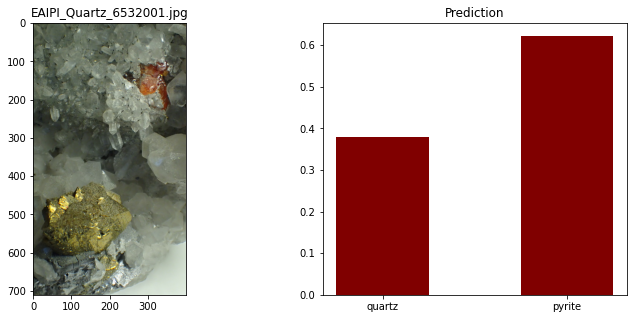

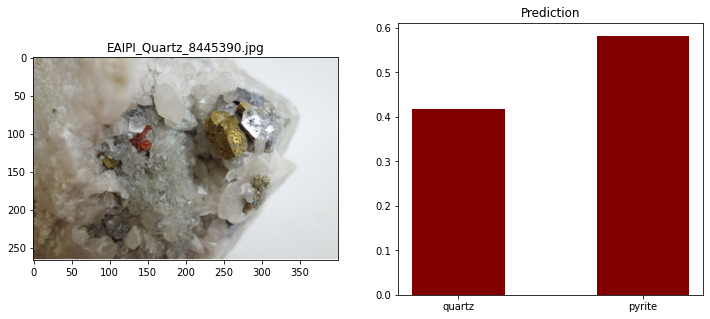

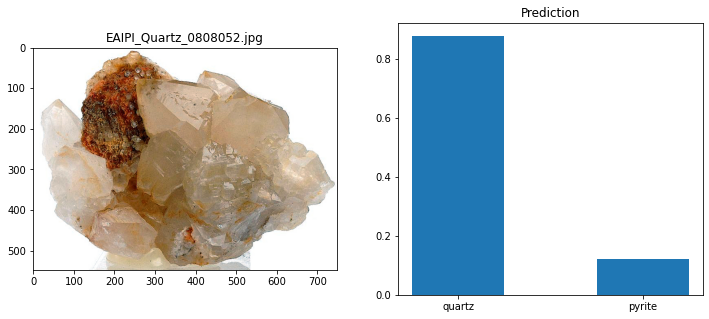

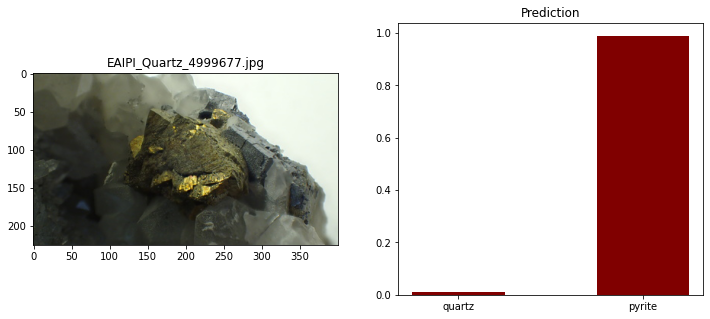

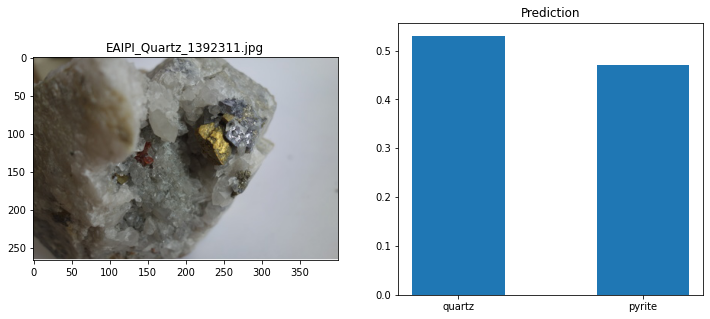

...

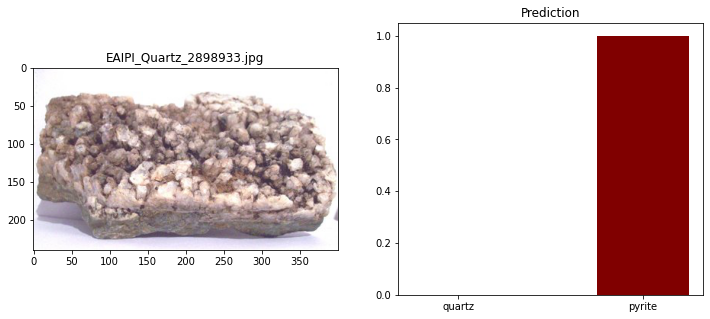

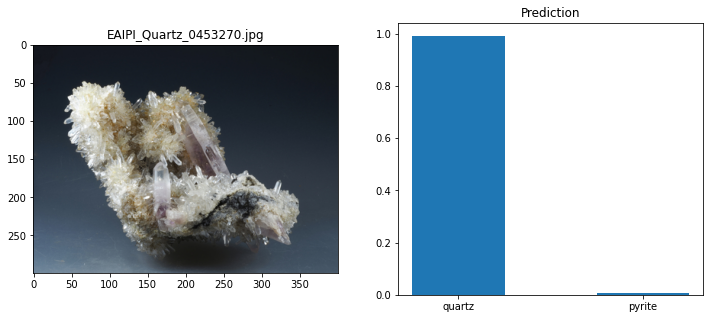

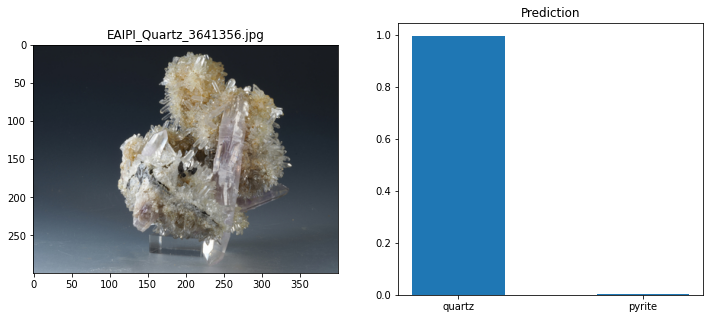

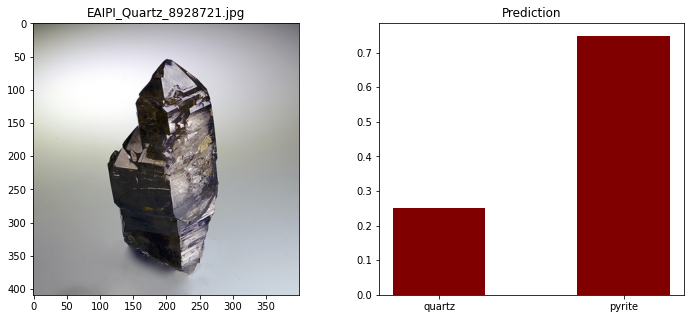

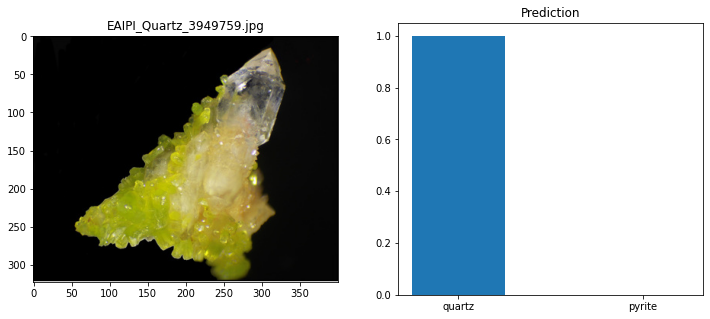

In [ ]:
doc = aw.Document()
builder = aw.DocumentBuilder(doc)

for i in range(len(y) - 1):

  if re.search(r'Quartz', x[i]):

    img = mpimg.imread(f'/content/drive/MyDrive/EIAPI/minerals/quartz/{x[i]}')

    fig = plt.figure(figsize = (12, 5))

    ax = fig.add_subplot(1, 2, 1)

    imgplot = plt.imshow(img)

    ax.set_title(f'{x[i]}')

    ax = fig.add_subplot(1, 2, 2)

    if y[i][0] < .5:

      plt.bar(class_names, y[i], width = 0.5, color ='maroon')

    else:

      plt.bar(class_names, y[i], width = 0.5)

    ax.set_title('Prediction')

  if re.search(r'Pyrite', x[i]):

    img = mpimg.imread(f'/content/drive/MyDrive/EIAPI/minerals/pyrite/{x[i]}')

    fig = plt.figure(figsize = (12, 5))

    ax = fig.add_subplot(1, 2, 1)

    imgplot = plt.imshow(img)

    ax.set_title(f'{x[i]}')

    ax = fig.add_subplot(1, 2, 2)

    if y[i][0] < .5:

      plt.bar(class_names, y[i], width = 0.5, color ='maroon')

    else:

      plt.bar(class_names, y[i], width = 0.5)

    ax.set_title('Prediction')

  plt.savefig(f'/content/drive/MyDrive/EIAPI/models/model_03/plots/plot_model_03_{i}.png')

  builder.insert_image(f'/content/drive/MyDrive/EIAPI/models/model_03/plots/plot_model_03_{i}.png')

doc.save('/content/drive/MyDrive/EIAPI/models/model_03/PDF/model_03_performance.pdf')

In [ ]:
model.save('/content/drive/MyDrive/EIAPI/models/model_03')